In [1]:
# Heavily inspired by https://bspeice.github.io/audio-compression-using-pca.html

In [2]:
!pip install -r requirements.txt > /dev/null 2>&1

In [4]:
import os
import subprocess
import time
import pandas as pd
import soundfile as sf
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from IPython.display import Audio

In [5]:
OUTPUT = 'out'
WAV = '.wav'
CCM = '.ccm'
MP3 = '.mp3'

In [6]:
simple, sampling_rate = sf.read('simple.wav')

In [110]:
Audio('simple.wav')

In [8]:
simple.shape

(3603968, 2)

In [112]:
padded_simple = np.pad(simple[:, 0], (0, 1024 - (simple.shape[0] % 1024)), mode='constant', constant_values=0)

In [113]:
reshaped_simple = padded_simple.reshape((len(padded_simple) // 1024, 1024))

In [114]:
u, s, vt = np.linalg.svd(reshaped_simple, full_matrices=False)
print("U:", u, "\n\nΣ:", s, "\n\nV.T:", vt)

U: [[-4.84902845e-04  3.88893641e-03 -2.40973994e-02 ... -5.72911289e-03
  -3.36946705e-02  1.42509611e-02]
 [ 2.35784176e-03 -2.77187002e-02 -3.55056240e-02 ... -6.59433022e-03
  -1.79359007e-02  1.58266649e-02]
 [ 6.40870772e-03  4.13546259e-02  5.24835819e-03 ... -2.52703574e-03
  -8.48869795e-03  2.52729297e-03]
 ...
 [ 3.16723966e-03  1.36518361e-04 -8.89557929e-03 ...  6.90836976e-03
   1.81353949e-02  5.18106526e-03]
 [-8.94209491e-04 -5.43674324e-04 -4.54396974e-03 ... -1.71224658e-02
   7.04246642e-03 -2.73525255e-02]
 [-2.47367653e-04  1.28180620e-03  3.98412746e-03 ... -9.69184846e-05
   1.66517180e-02 -6.56867230e-03]] 

Σ: [1.38662849e+01 1.35246928e+01 7.70299160e+00 ... 3.73891588e-04
 3.70360783e-04 3.70176005e-04] 

V.T: [[ 3.69543419e-02  3.68784446e-02  3.68289667e-02 ... -3.50271278e-02
  -3.46844487e-02 -3.40257828e-02]
 [-1.73981841e-03 -1.20777149e-03 -5.64828973e-04 ... -1.36810630e-02
  -1.37325922e-02 -1.39166483e-02]
 [ 1.68039123e-02  1.84242331e-02  2.01810

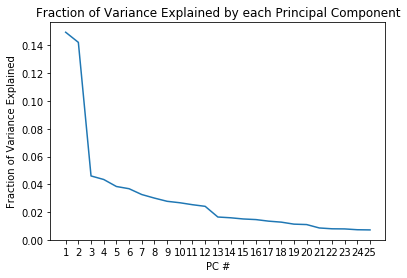

In [115]:
plt.plot(list(range(1, 26)), s[:25]**2 / sum(s**2));
plt.xticks(list(range(1, 26)), list(range(1, 26)));
plt.xlabel('PC #');
plt.ylabel('Fraction of Variance Explained');
plt.title('Fraction of Variance Explained by each Principal Component');

In [116]:
compressed_simple = (u[:, :32] @ np.diag(s[:32]) @ vt[:32, :])

In [117]:
sf.write(OUTPUT + WAV, compressed_simple.reshape(len(padded_simple)), sampling_rate)
os.rename(OUTPUT + WAV, OUTPUT + CCM) # be sure to open .ccm files in DAWs such as Audacity

In [9]:
def ccm(signal, n_dim, n_com, plot=False):
    # pad input with 0's until it is a multiple of `n_dim`,
    # the number of desired dimensions the signal's matrix representation
    padded = np.pad(signal[:, 0], (0, n_dim - (signal.shape[0] % n_dim)), mode='constant', constant_values=0)
    
    # reshape the input signal to have `n_dim` dimensions (columns)
    reshaped = padded.reshape((len(padded) // n_dim, n_dim))
    
    # run Singular Value Decomposition (SVD) to compute U, Σ, and V.T
    u, s, vt = np.linalg.svd(reshaped, full_matrices=False)
    
    # plot the variance explained by first `min(len(s), 25))` principal components
    if plot:
        plot_pc_var(s, min(len(s), 25))
        
    n_com = min(len(s), n_com)
    
    # slice off unwanted columns of the signal, keeping only `n_com` principal components
    compressed = (u[:, :n_com] @ np.diag(s[:n_com]) @ vt[:n_com, :])
    
    # reconstruct original signal in a lossy fashion
    return compressed.reshape(len(padded))

In [10]:
def plot_pc_var(sigma, n):
    assert n >= 1, 'n must be greater than or equal to 1'
    plt.plot(list(range(1, n + 1)), sigma[:n] ** 2 / sum(sigma ** 2));
    plt.xticks(list(range(1, n + 1)), list(range(1, n + 1)));
    plt.xlabel('PC #');
    plt.ylabel('Fraction of Variance Explained');
    plt.title('Fraction of Variance Explained by each Principal Component');

In [11]:
def compare_ccm_mp3(src):
    original_size = round(os.path.getsize(src) / (10 ** 6), 4)
    ccm_times, ccm_sizes = [], []
    mp3_times, mp3_sizes = [], []
    audio_ccm, sampling_rate = sf.read(src)
#     audio_mp3 = AudioSegment.from_file(src)
    encode_mp3 = f'ffmpeg -i {src} -vn -ar {sampling_rate} -ac 2 -b:a 192k {OUTPUT + MP3}'
    for d in range(17):
        t0 = time.time()
        sf.write(OUTPUT + WAV, ccm(audio_ccm, 1024, 32), sampling_rate)
        t1 = time.time()
        ccm_times.append(round(t1 - t0, 2))
        size = round(os.path.getsize(OUTPUT + WAV) / (10 ** 6), 4)
        ccm_sizes.append(size)
        t0 = time.time()
        process = subprocess.Popen(encode_mp3.split(), stdout=subprocess.PIPE)
        output, error = process.communicate()
#         audio_mp3.export(OUTPUT, format="mp3", codec="libmp3lame")
        t1 = time.time()
        mp3_times.append(round(t1 - t0, 2))
        size = round(os.path.getsize(OUTPUT + MP3) / (10 ** 6), 4)
        mp3_sizes.append(size)
        os.remove(OUTPUT + MP3)
    return ccm_times, ccm_sizes, mp3_times, mp3_sizes, original_size

In [136]:
Audio('complex.wav')

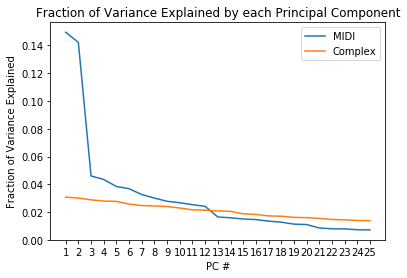

In [12]:
ccm(sf.read('simple.wav')[0], 1024, 32, plot=True), ccm(sf.read('complex.wav')[0], 1024, 32, plot=True)
plt.legend(['MIDI', 'Complex']);

In [13]:
ccm_times, ccm_sizes, mp3_times, mp3_sizes, original_size = compare_ccm_mp3('complex.wav')
# if you have issues with ffmpeg not having mp3 encoders read this: 
# https://stackoverflow.com/questions/53370739/error-audio-conversion-failed-unknown-encoder-libmp3lame

In [16]:
def time_comparison(src, ccm_times, mp3_times):
    data = {
        'ccm time (sec)': ccm_times,
        'mp3 time (sec)': mp3_times,
    }
    df = pd.DataFrame(data=data)
    sns.displot(df, kind='kde')
    plt.xlabel('runtime (sec)')
    plt.title(src)
    return df

,ccm time (sec),mp3 time (sec)
0,0.89,1.54
1,0.91,1.35
2,1.01,1.29
3,1.01,1.46
4,0.99,1.42
5,1.01,1.50
6,1.14,1.34
7,1.18,1.30
8,0.99,1.24
9,1.32,1.54


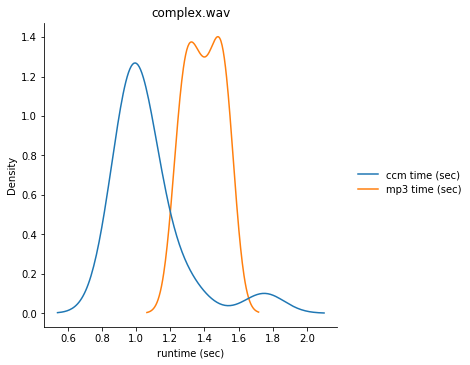

In [17]:
time_comparison('complex.wav', ccm_times, mp3_times)

In [18]:
def space_comparison(src, ccm_sizes, mp3_sizes, original_size):
    ccm_factor = np.mean(ccm_sizes) / original_size
    mp3_factor = np.mean(mp3_sizes) / original_size
    res = f'ccm compressed {src} to {round(ccm_factor * 100, 2)}% of its original size'
    res += f'\nmp3 compressed {src} to {round(mp3_factor * 100, 2)}% of its original size'
    return res

In [19]:
print(space_comparison('complex.wav', ccm_sizes, mp3_sizes, original_size))

ccm compressed complex.wav to 50.0% of its original size
mp3 compressed complex.wav to 31.27% of its original size


,ccm time (sec),mp3 time (sec)
0,0.94,1.61
1,1.02,1.40
2,0.97,1.37
3,1.22,1.39
4,0.99,1.51
5,1.14,1.53
6,0.92,1.35
7,0.93,1.35
8,1.10,1.56
9,1.15,1.49


ccm compressed simple.wav to 50.01% of its original size
mp3 compressed simple.wav to 13.62% of its original size


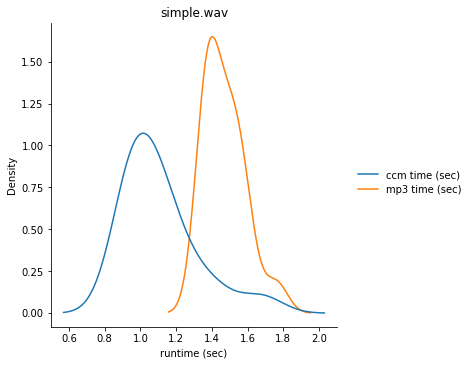

In [21]:
ccm_times, ccm_sizes, mp3_times, mp3_sizes, original_size = compare_ccm_mp3('simple.wav')
display(time_comparison('simple.wav', ccm_times, mp3_times))
print(space_comparison('simple.wav', ccm_sizes, mp3_sizes, original_size))